<a href="https://colab.research.google.com/github/ingsol/maching_learning/blob/main/cycleGAN_rococo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# basic packages
import numpy as np
import pandas as pd
import scipy
import pickle
import random
import os

# loading in and transforming data
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torchvision.utils import make_grid
import PIL
from PIL import Image
import imageio

# visualizing data
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
cd /content/gdrive/MyDrive/Colab Notebooks/서울대 핀테크_파이썬/딥러닝(PyTorch)/project

/content/gdrive/MyDrive/Colab Notebooks/서울대 핀테크_파이썬/딥러닝(PyTorch)/project


In [ ]:
os.getcwd()

'/content/gdrive/MyDrive/Colab Notebooks/서울대 핀테크_파이썬/딥러닝(PyTorch)/project'

In [ ]:
!ls

'Copy of cycleGAN_ironman_1.ipynb'   cycleGAN_xmas_1.ipynb   rococo2room
'Copy of cycleGAN_xmas.ipynb'	     cycleGAN_xmas.ipynb     rococo2room_1
 cycleGAN_ghibli_수정.ipynb	     ghibli2room	     rococo2room_split
 cycleGAN_ghibli.ipynb		     ghibli2room_split	     saved_models
 cycleGAN_ironman.ipynb		     images		     xmas2room
 cycleGAN_rococo_1.ipynb	     ironman2car	     xmas2room_1
 cycleGAN_rococo.ipynb		     ironman2car_1


 **Code 0. Path**

In [ ]:
# Paths
path_save_up_to_5gb = '/result'
path_picture = './rococo2room/rococo_jpg/'
path_room = './rococo2room/room_jpg/'
img_size = 256

In [ ]:
def set_seed(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True

In [ ]:
set_seed(1234)

 **Code 1. Save and load**

In [ ]:
def save_checkpoint(iteration, G_XtoY, G_YtoX, D_X, D_Y, checkpoint_dir='/result'):
    """
    Saves the parameters of both generators and discriminators.
    """
    #Path
    G_XtoY_path = os.path.join(checkpoint_dir, 'G_XtoY.pkl')
    G_YtoX_path = os.path.join(checkpoint_dir, 'G_YtoX.pkl')
    D_X_path = os.path.join(checkpoint_dir, 'D_X.pkl')
    D_Y_path = os.path.join(checkpoint_dir, 'D_Y.pkl')
    #Saving
    torch.save(G_XtoY.state_dict(), G_XtoY_path)
    torch.save(G_YtoX.state_dict(), G_YtoX_path)
    torch.save(D_X.state_dict(), D_X_path)
    torch.save(D_Y.state_dict(), D_Y_path)

In [ ]:
def load_checkpoint(checkpoint_path, map_location=None):
    """
    Load checkoint
    """
    #model.load_state_dict(torch.load(checkpoint_path))
    checkpoint = torch.load(checkpoint_path, map_location=map_location)
    print(' [*] Loading checkpoint from %s succeed!' % checkpoint_path)
    return checkpoint

In [ ]:
def show_test(fixed_Y, fixed_X, G_YtoX, G_XtoY, mean_=0.5, std_=0.5):
    """
    Shows results of generates based on test image input. 
    """
    #Identify correct device
    device = torch.device('cuda' if torch.cuda.is_available() else "cpu")
    
    #Create fake pictures for both cycles
    fake_X = G_YtoX(fixed_Y.to(device))
    fake_Y = G_XtoY(fixed_X.to(device))
    
    #Generate grids
    grid_x =  make_grid(fixed_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_y =  make_grid(fixed_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_fake_x =  make_grid(fake_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    grid_fake_y =  make_grid(fake_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
    
    #Normalize pictures to pixel range rom 0 to 255
    X, fake_X = reverse_normalize(grid_x, mean_, std_), reverse_normalize(grid_fake_x, mean_, std_)
    Y, fake_Y = reverse_normalize(grid_y, mean_, std_), reverse_normalize(grid_fake_y, mean_, std_)
    
    #Transformation from X -> Y
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(36, 24))
    ax1.imshow(X)
    ax1.axis('off')
    ax1.set_title('X')
    ax2.imshow(fake_Y)
    ax2.axis('off')
    ax2.set_title('Fake Y  (rococo-style)')
    plt.show()

 **Code 2. Datasets & Dataloaders**

In [ ]:
def to_rgb(image):
    rgb_image = Image.new("RGB", image.size)
    rgb_image.paste(image)
    return rgb_image


class ReplayBuffer:
    def __init__(self, max_size=50):
        assert max_size > 0
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        to_return = []
        for element in data.data:
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if random.uniform(0, 1) > 0.5:
                    i = random.randint(0, self.max_size - 1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        return Variable(torch.cat(to_return))

In [ ]:
class ImageDataset(Dataset):
        """
        Custom dataset
        """
        
        def __init__(self, img_path, img_size=256, normalize=True):
            self.img_path = img_path
            
            if normalize:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.5], std=[0.5])
                ])
            else:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor()
                ])
            
            #Dictionary entries
            self.img_idx = dict()
            for number_, img_ in enumerate(os.listdir(self.img_path)):
                self.img_idx[number_] = img_
                
        def __len__(self):
            #Length of dataset --> number of images
            return len(self.img_idx)
        
        def __getitem__(self, idx):
            img_path = os.path.join(self.img_path, self.img_idx[idx])
            img = Image.open(img_path)
            img = self.transform(img)
            
            return img

In [ ]:
def reverse_normalize(image, mean_=0.5, std_=0.5):
    if torch.is_tensor(image):
        image = image.detach().numpy()
    un_normalized_img = image * std_ + mean_
    un_normalized_img = un_normalized_img * 255
    return np.uint8(un_normalized_img)

In [ ]:
#Create datasets
dataset_picture = ImageDataset(path_picture, img_size=256, normalize=True) #picture
dataset_room = ImageDataset(path_room, img_size=256, normalize=True) #room

여기 사진 개수!!

In [ ]:
#Create test loaders
batch_size_test = 20
batch_size= 40
test_dataloader_Y = DataLoader(dataset_picture, batch_size=batch_size_test, shuffle=False, num_workers=0, pin_memory=True)
test_dataloader_X = DataLoader(dataset_room, batch_size=batch_size_test, shuffle=False, num_workers=0, pin_memory=True)
dataloader_Y = DataLoader(dataset_picture, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)
dataloader_X = DataLoader(dataset_room, batch_size=batch_size, shuffle=True, num_workers=0, pin_memory=True)

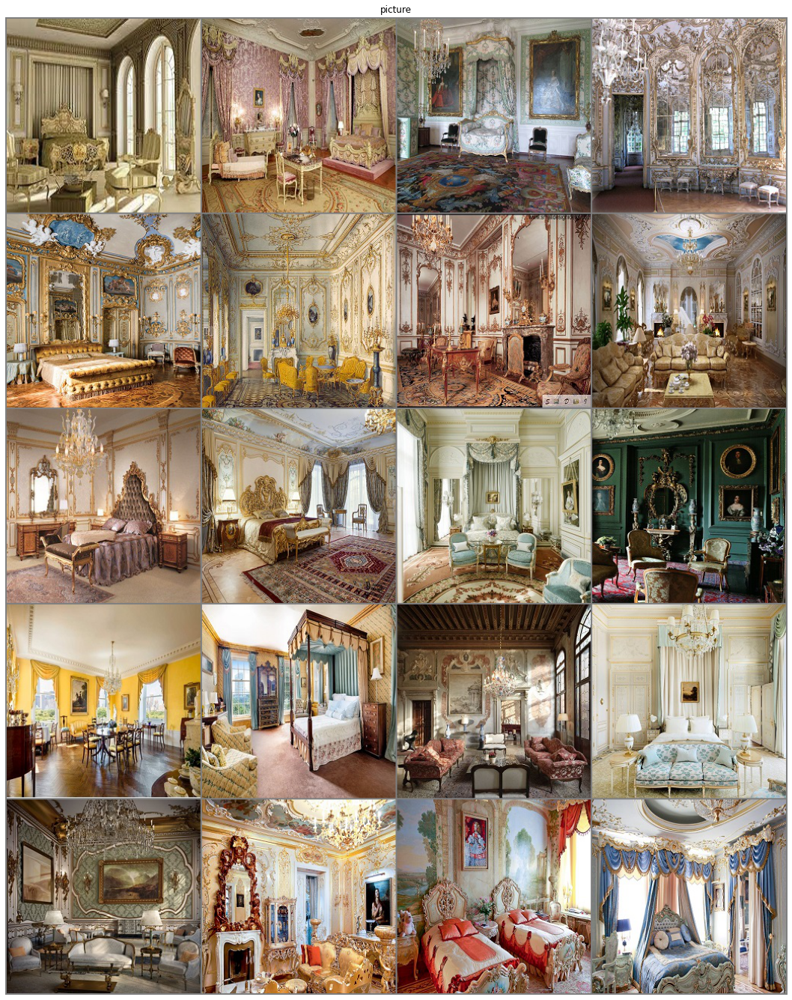

In [ ]:
#Check dataset & dataloader results
dataiter = iter(test_dataloader_Y)
images_normalized = dataiter.next()
grid_normalized = make_grid(images_normalized, nrow=4).permute(1, 2, 0).detach().numpy()
grid_original = reverse_normalize(grid_normalized)
fig = plt.figure(figsize=(36, 24))
plt.imshow(grid_original)
plt.axis('off')
plt.title('picture')
plt.show()

 **Code 3. Model**

**Discriminator**

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=False, instance_norm=False):
    """
    Creates a convolutional layer, with optional batch / instance normalization. 
    """
    
    #Add layers
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    layers.append(conv_layer)
    
    #Batch normalization
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    return nn.Sequential(*layers)

In [ ]:
class Discriminator(nn.Module):
    
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        """
        Input is RGB image (256x256x3) while output is a single value
        
        determine size = [(W−K+2P)/S]+1
        W: input=256
        K: kernel_size=4
        P: padding=1
        S: stride=2
        """
        
        #convolutional layers, increasing in depth
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=4) # (128, 128, 64)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=4, instance_norm=True) # (32, 32, 256)
        self.conv4 = conv(in_channels=conv_dim*4, out_channels=conv_dim*8, kernel_size=4, instance_norm=True) # (16, 16, 512)
        self.conv5 = conv(in_channels=conv_dim*8, out_channels=conv_dim*8, kernel_size=4, batch_norm=True) # (8, 8, 512)
        
        #final classification layer
        self.conv6 = conv(conv_dim*8, out_channels=1, kernel_size=4, stride=1) # (8, 8, 1)
    
    def forward(self, x):
        
        #leaky relu applied to all conv layers but last
        out = F.leaky_relu(self.conv1(x), negative_slope=0.2)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.2)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.2)
        out = F.leaky_relu(self.conv4(out), negative_slope=0.2)
#         out = F.leaky_relu(self.conv5(out), negative_slope=0.2)
        
        #classification layer (--> depending on the loss function we might want to use an activation function here, e.g. sigmoid)
        out = self.conv6(out)
        return out

**Generator**

In [ ]:
class ResidualBlock(nn.Module):

    def __init__(self, conv_dim):
        super(ResidualBlock, self).__init__()
        """
        Residual blocks help the model to effectively learn the transformation from one domain to another. 
        """
        self.conv1 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        
    def forward(self, x):
        out_1 = F.relu(self.conv1(x))
        out_2 = x + self.conv2(out_1)
        return out_2

In [ ]:
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=False, instance_norm=False, dropout=False, dropout_ratio=0.5):
    """
    Creates a transpose convolutional layer, with optional batch / instance normalization. Select either batch OR instance normalization. 
    """
    
    #Add layers
    layers = []
    layers.append(nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False))
    
    #Batch normalization
    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    
    #Dropout
    if dropout:
        layers.append(nn.Dropout2d(dropout_ratio))
    
    return nn.Sequential(*layers)

In [ ]:
class CycleGenerator(nn.Module):
    
    def __init__(self, conv_dim=64, n_res_blocks=6):
        super(CycleGenerator, self).__init__()
        """
        Input is RGB image (256x256x3) while output is a single value
        
        determine size = [(W−K+2P)/S]+1
        W: input=256
        K: kernel_size=4
        P: padding=1
        S: stride=2
        """
        
        #Encoder layers
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=4) # (128, 128, 64)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=4, instance_norm=True) # (32, 32, 256)
        
        #Residual blocks (number depends on input parameter)
        res_layers = []
        for layer in range(n_res_blocks):
            res_layers.append(ResidualBlock(conv_dim*4))
        self.res_blocks = nn.Sequential(*res_layers)
        
        #Decoder layers
        self.deconv4 = deconv(in_channels=conv_dim*4, out_channels=conv_dim*2, kernel_size=4, instance_norm=True) # (64, 64, 128)
        self.deconv5 = deconv(in_channels=conv_dim*2, out_channels=conv_dim, kernel_size=4, instance_norm=True) # (128, 128, 64)
        self.deconv6 = deconv(in_channels=conv_dim, out_channels=3, kernel_size=4, instance_norm=True) # (256, 256, 3)
        
    def forward(self, x):
        """
        Given an image x, returns a transformed image.
        """
        
        #Encoder
        out = F.leaky_relu(self.conv1(x), negative_slope=0.2) # (128, 128, 64)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.2) # (64, 64, 128)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.2) # (32, 32, 256)
        
        #Residual blocks
        out = self.res_blocks(out)
        
        #Decoder
        out = F.leaky_relu(self.deconv4(out), negative_slope=0.2) # (64, 64, 128)
        out = F.leaky_relu(self.deconv5(out), negative_slope=0.2) # (128, 128, 64)
        out = torch.tanh(self.deconv6(out)) # (256, 256, 3)
        
        return out

In [ ]:
from torch.nn import init
def weights_init_normal(m):
    """
    Applies initial weights to certain layers in a model.
    The weights are taken from a normal distribution with mean = 0, std dev = 0.02.
    Param m: A module or layer in a network    
    """
    #classname will be something like: `Conv`, `BatchNorm2d`, `Linear`, etc.
    classname = m.__class__.__name__
    
    #normal distribution with given paramters
    std_dev = 0.02
    mean = 0.0
    
    # Initialize conv layer
    if hasattr(m, 'weight') and (classname.find('Conv') != -1):
        init.normal_(m.weight.data, mean, std_dev)

In [ ]:
def build_model(g_conv_dim=64, d_conv_dim=64, n_res_blocks=6):
    """
    Builds generators G_XtoY & G_YtoX and discriminators D_X & D_Y 
    """
    
    #Generators
    G_XtoY = CycleGenerator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    G_YtoX = CycleGenerator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    
    #Discriminators
    D_X = Discriminator(conv_dim=d_conv_dim) # Y-->X
    D_Y = Discriminator(conv_dim=d_conv_dim) # X-->Y
    
    #Weight initialization
    G_XtoY.apply(weights_init_normal)
    G_YtoX.apply(weights_init_normal)
    D_X.apply(weights_init_normal)
    D_Y.apply(weights_init_normal)
    
    #Moves models to GPU, if available
    if torch.cuda.is_available():
        device = torch.device("cuda")
        G_XtoY.to(device)
        G_YtoX.to(device)
        D_X.to(device)
        D_Y.to(device)
        print('Models moved to GPU.')
    else:
        print('Only CPU available.')

    return G_XtoY, G_YtoX, D_X, D_Y

In [ ]:
#Function call
G_XtoY, G_YtoX, D_X, D_Y = build_model()

Models moved to GPU.


In [ ]:
#Check model structure
def print_build(G_XtoY, G_YtoX, D_X, D_Y):
    print("                     G_XtoY                    ")
    print("-----------------------------------------------")
    print(G_XtoY)
    print()

    print("                     G_YtoX                    ")
    print("-----------------------------------------------")
    print(G_YtoX)
    print()

    print("                      D_X                      ")
    print("-----------------------------------------------")
    print(D_X)
    print()

    print("                      D_Y                      ")
    print("-----------------------------------------------")
    print(D_Y)
    print()
    
print_build(G_XtoY, G_YtoX, D_X, D_Y)

                     G_XtoY                    
-----------------------------------------------
CycleGenerator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (conv2): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3)

**Code 4. Loss function**
- Adversarial loss: GAN loss, target domain의 있을 법한 이미지를 만들 수 있도록 하는 역할을 수행한다.
- Cycle consistency loss: 입력과 매칭되는 image-to-image translation 결과 이미지를 찾을 수 있도록, 입력 이미지 x에 대해서 그럴싸한 매칭되는 이미지 y를 찾을 수 있도록 encourage, 이미지 x가 생성자 G를 거쳐서 y 도메인의 이미지로 변경될 수 있도록하고, DiscriminatorY에 의해서 y도메인의 그럴싸한 이미지가 될 수 있도록 해준다. 다시 F를 거쳐서 x도메인의 이미지로 돌아올 수 있도록 해준다. 
cycle을 거쳐서 돌아온 이미지가 원본 이미지에 최대한 가까워질 수 있도록 loss를 구해서 거리가 가까워지도록 해준다.
- Identity loss

In [ ]:
def real_mse_loss(D_out, adverserial_weight=1):
    #how close is the produced output from being "real"?
    mse_loss = torch.mean((D_out-1)**2)*adverserial_weight
    return mse_loss

def fake_mse_loss(D_out, adverserial_weight=1):
    #how close is the produced output from being "false"?
    mse_loss = torch.mean(D_out**2)*adverserial_weight
    return mse_loss

def cycle_consistency_loss(real_img, reconstructed_img, lambda_weight=1):
    reconstr_loss = torch.mean(torch.abs(real_img - reconstructed_img))
    return lambda_weight*reconstr_loss 

def identity_loss(real_img, generated_img, identity_weight=1):
    ident_loss = torch.mean(torch.abs(real_img - generated_img))
    return identity_weight*ident_loss

**Code 5. Optimizers**

In [ ]:
import torch.optim as optim

#hyperparameter
lr=0.0002 #0.0002
beta1=0.500 #exponential decay rate for the first moment estimates
beta2=0.999 #exponential decay rate for the second-moment estimates
g_params = list(G_XtoY.parameters()) + list(G_YtoX.parameters())

#Optimizers for generator and discriminator
g_optimizer = optim.Adam(g_params, lr, [beta1, beta2])
d_x_optimizer = optim.Adam(D_X.parameters(), lr, [beta1, beta2])
d_y_optimizer = optim.Adam(D_Y.parameters(), lr, [beta1, beta2])

**Code 6. Training**

In [ ]:
def training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=1000):
    
    #Losses over time
    losses = []
    
    #Additional weighting parameters (in reality only 2 are required as the third is kind of "given relatively" by the other two)
    adverserial_weight = 0.5
    lambda_weight = 10
    identity_weight = 5
    
    #Get some fixed data from domains X and Y for sampling. Images are held constant throughout training and allow us to inspect the model's performance.
    test_iter_X = iter(test_dataloader_X)
    test_iter_Y = iter(test_dataloader_Y)
    fixed_X = test_iter_X.next()
    fixed_Y = test_iter_Y.next()
    
    # batches per epoch
    iter_X = iter(dataloader_X)
    iter_Y = iter(dataloader_Y)
    batches_per_epoch = min(len(iter_X), len(iter_Y))
    
    #Average loss over batches per epoch runs
    d_total_loss_avg = 0.0
    g_total_loss_avg = 0.0
    
    #Loop through epochs
    for epoch in range(1, n_epochs+1):
        
        #reset iterators for each epoch
        if epoch % batches_per_epoch == 0:
            iter_X = iter(dataloader_X)
            iter_Y = iter(dataloader_Y)
        
        #Get images from domain X
        images_X = iter_X.next()
        
        #Get images from domain Y
        images_Y = iter_Y.next()
        
        #move images to GPU if available (otherwise stay on CPU)
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        images_X = images_X.to(device)
        images_Y = images_Y.to(device)
        
        
        # ============================================
        #            TRAIN THE DISCRIMINATORS
        # ============================================
        
        
        # --------------------------------------------
        ## First: D_X, real and fake loss components
        # --------------------------------------------
        
        # Train with real images
        d_x_optimizer.zero_grad()
        
        # 1. Compute the discriminator losses on real images
        out_x = D_X(images_X)
        D_X_real_loss = real_mse_loss(out_x, adverserial_weight)
        
        # Train with fake images
        # 2. Generate fake images that look like domain X based on real images in domain Y
        fake_X = G_YtoX(images_Y)

        # 3. Compute the fake loss for D_X
        out_x = D_X(fake_X)
        D_X_fake_loss = fake_mse_loss(out_x, adverserial_weight)
        
        # 4. Compute the total loss and perform backpropagation
        d_x_loss = D_X_real_loss + D_X_fake_loss
        d_x_loss.backward()
        d_x_optimizer.step()
        
        # --------------------------------------------
        ## Second: D_Y, real and fake loss components
        # --------------------------------------------
        
        # Train with real images
        d_y_optimizer.zero_grad()
        
        # 1. Compute the discriminator losses on real images
        out_y = D_Y(images_Y)
        D_Y_real_loss = real_mse_loss(out_y, adverserial_weight)
        
        # Train with fake images
        # 2. Generate fake images that look like domain Y based on real images in domain X
        fake_Y = G_XtoY(images_X)
        
        # 3. Compute the fake loss for D_Y
        out_y = D_Y(fake_Y)
        D_Y_fake_loss = fake_mse_loss(out_y, adverserial_weight)
        
        # 4. Compute the total loss and perform backprop
        d_y_loss = D_Y_real_loss + D_Y_fake_loss
        d_y_loss.backward()
        d_y_optimizer.step()
        
        # 5. Compute total discriminator loss
        d_total_loss = D_X_real_loss + D_X_fake_loss + D_Y_real_loss + D_Y_fake_loss
        

        # =========================================
        #            TRAIN THE GENERATORS
        # =========================================
        
        
        # --------------------------------------------
        ## First: generate fake X images and reconstructed Y images
        # --------------------------------------------
        
        #Back to the start
        g_optimizer.zero_grad()
        
        # 1. Generate fake images that look like domain X based on real images in domain Y
        fake_X = G_YtoX(images_Y)
        
        # 2. Compute the generator loss based on domain X
        out_x = D_X(fake_X)
        g_YtoX_loss = real_mse_loss(out_x, adverserial_weight)

        # 3. Create a reconstructed y
        reconstructed_Y = G_XtoY(fake_X)
        
        # 4. Compute the cycle consistency loss (the reconstruction loss)
        reconstructed_y_loss = cycle_consistency_loss(images_Y, reconstructed_Y, lambda_weight=lambda_weight)
        
        # 5. Compute the identity loss from transformation Y-->X
        identity_y_loss = identity_loss(images_Y, fake_X, identity_weight=identity_weight)
        
        # --------------------------------------------
        ## Second: generate fake Y images and reconstructed X images
        # --------------------------------------------
        
        # 1. Generate fake images that look like domain Y based on real images in domain X
        fake_Y = G_XtoY(images_X)
        
        # 2. Compute the generator loss based on domain Y
        out_y = D_Y(fake_Y) #if discriminator believes picture to be from domain Y it returns values cloer to 1, else closer to 0
        g_XtoY_loss = real_mse_loss(out_y, adverserial_weight)
        
        # 3. Create a reconstructed x
        reconstructed_X = G_YtoX(fake_Y)
        
        # 4. Compute the cycle consistency loss (the reconstruction loss)
        reconstructed_x_loss = cycle_consistency_loss(images_X, reconstructed_X, lambda_weight=lambda_weight)
        
        # 5. Compute the identity loss from transformation X-->Y
        identity_x_loss = identity_loss(images_X, fake_Y, identity_weight=identity_weight)
        
        # 6. Add up all generator and reconstructed losses and perform backprop
        g_total_loss = g_YtoX_loss + g_XtoY_loss + reconstructed_y_loss + reconstructed_x_loss + identity_y_loss + identity_x_loss
        g_total_loss.backward()
        g_optimizer.step()
        
        
        # =========================================
        # Admin 
        # =========================================
        
        
        #Average loss
        d_total_loss_avg = d_total_loss_avg + d_total_loss / batches_per_epoch
        g_total_loss_avg = g_total_loss_avg + g_total_loss / batches_per_epoch
        
        # Print log info
        print_every = batches_per_epoch
        if epoch % print_every == 0:
            # append real and fake discriminator losses and the generator loss
            losses.append((d_total_loss_avg.item(), g_total_loss_avg.item()))
            true_epoch_n = int(epoch/batches_per_epoch)
            true_epoch_total = int(n_epochs/batches_per_epoch)
            print('Epoch [{:5d}/{:5d}] | d_total_loss_avg: {:6.4f} | g_total_loss: {:6.4f}'.format(
                    true_epoch_n, true_epoch_total, d_total_loss_avg.item(), g_total_loss_avg.item()))
        
        #Show the generated samples
        show_every = (batches_per_epoch*10)
        if epoch % show_every == 0:
            #set generators to eval mode for image generation
            G_YtoX.eval()
            G_XtoY.eval()
            test_images = show_test(fixed_Y, fixed_X, G_YtoX, G_XtoY)
            #set generators to train mode to continue training
            G_YtoX.train()
            G_XtoY.train()
        
#         #save the model parameters
#         checkpoint_every=3000
#         if epoch % checkpoint_every == 0:
#             save_checkpoint(epoch, G_XtoY, G_YtoX, D_X, D_Y)
    
        #reset average loss for each epoch
        if epoch % batches_per_epoch == 0:
            d_total_loss_avg = 0.0
            g_total_loss_avg = 0.0
    
    return losses

In [ ]:
batches_per_epoch = min(len(dataloader_X), len(dataloader_Y))
epoch_true = 256

Epoch [    1/  256] | d_total_loss_avg: 3.3436 | g_total_loss: 20.9564
Epoch [    2/  256] | d_total_loss_avg: 7.5945 | g_total_loss: 21.9162
Epoch [    3/  256] | d_total_loss_avg: 5.1429 | g_total_loss: 21.8087
Epoch [    4/  256] | d_total_loss_avg: 4.3655 | g_total_loss: 20.9372
Epoch [    5/  256] | d_total_loss_avg: 3.6757 | g_total_loss: 20.3026
Epoch [    6/  256] | d_total_loss_avg: 5.3432 | g_total_loss: 19.7409
Epoch [    7/  256] | d_total_loss_avg: 4.4625 | g_total_loss: 18.7120
Epoch [    8/  256] | d_total_loss_avg: 4.8584 | g_total_loss: 18.9250
Epoch [    9/  256] | d_total_loss_avg: 4.5174 | g_total_loss: 17.9760
Epoch [   10/  256] | d_total_loss_avg: 3.8865 | g_total_loss: 16.1237


<Figure size 2592x1728 with 0 Axes>

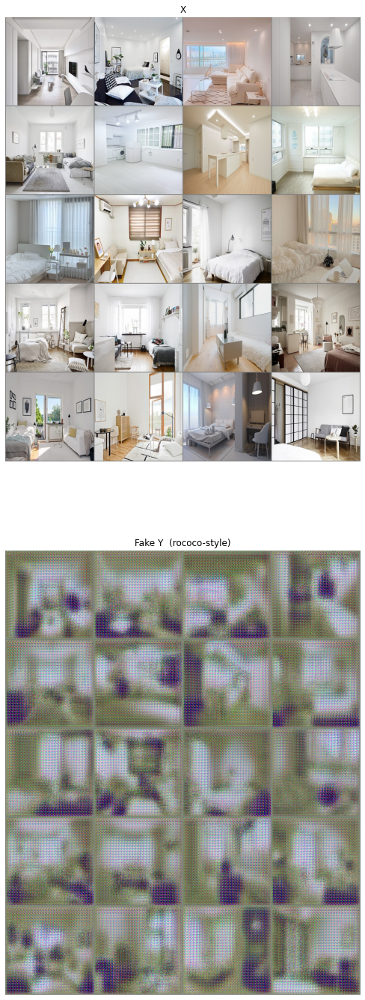

Epoch [   11/  256] | d_total_loss_avg: 1.7800 | g_total_loss: 14.5340
Epoch [   12/  256] | d_total_loss_avg: 1.6005 | g_total_loss: 14.0500
Epoch [   13/  256] | d_total_loss_avg: 1.3794 | g_total_loss: 13.2428
Epoch [   14/  256] | d_total_loss_avg: 1.0274 | g_total_loss: 12.7168
Epoch [   15/  256] | d_total_loss_avg: 0.9639 | g_total_loss: 12.3628
Epoch [   16/  256] | d_total_loss_avg: 0.9066 | g_total_loss: 12.0266
Epoch [   17/  256] | d_total_loss_avg: 0.8328 | g_total_loss: 11.7914
Epoch [   18/  256] | d_total_loss_avg: 0.7672 | g_total_loss: 11.5475
Epoch [   19/  256] | d_total_loss_avg: 0.7307 | g_total_loss: 11.4076
Epoch [   20/  256] | d_total_loss_avg: 0.7023 | g_total_loss: 11.2154


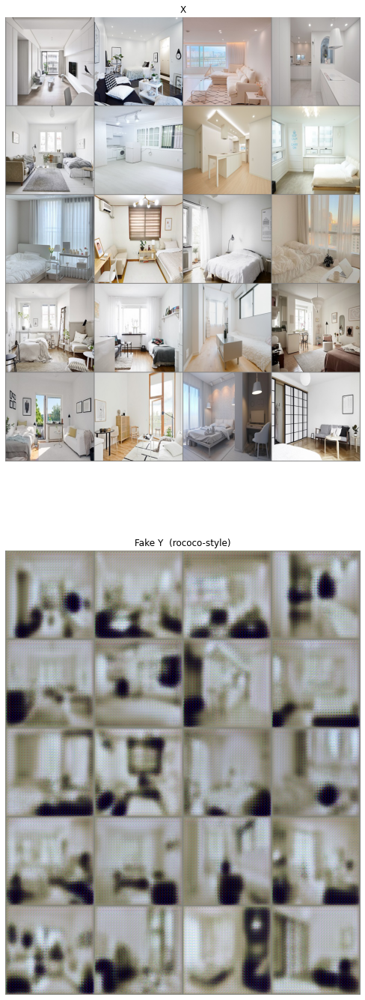

Epoch [   21/  256] | d_total_loss_avg: 0.6712 | g_total_loss: 11.1878
Epoch [   22/  256] | d_total_loss_avg: 0.6906 | g_total_loss: 11.1168
Epoch [   23/  256] | d_total_loss_avg: 0.7766 | g_total_loss: 11.3493
Epoch [   24/  256] | d_total_loss_avg: 1.0159 | g_total_loss: 11.9538
Epoch [   25/  256] | d_total_loss_avg: 1.6094 | g_total_loss: 12.3831
Epoch [   26/  256] | d_total_loss_avg: 2.3761 | g_total_loss: 12.8114
Epoch [   27/  256] | d_total_loss_avg: 2.4104 | g_total_loss: 12.0225
Epoch [   28/  256] | d_total_loss_avg: 1.4866 | g_total_loss: 11.7056
Epoch [   29/  256] | d_total_loss_avg: 1.6892 | g_total_loss: 11.2458
Epoch [   30/  256] | d_total_loss_avg: 1.1389 | g_total_loss: 10.7092


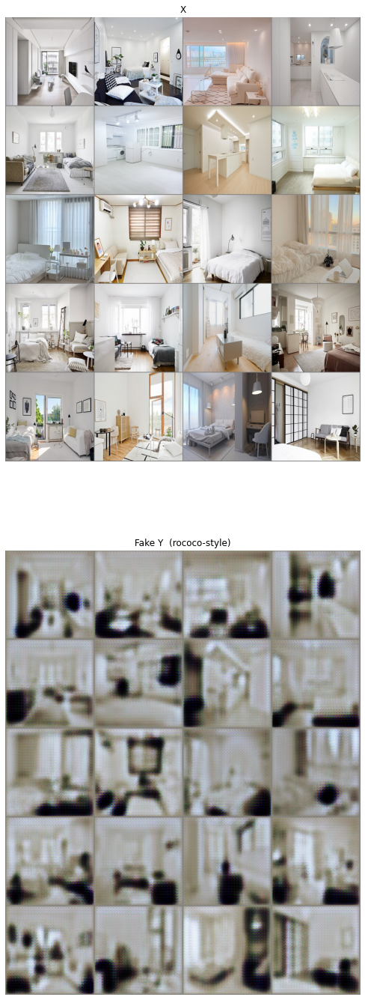

Epoch [   31/  256] | d_total_loss_avg: 0.6617 | g_total_loss: 10.4594
Epoch [   32/  256] | d_total_loss_avg: 0.5136 | g_total_loss: 10.3852
Epoch [   33/  256] | d_total_loss_avg: 0.4937 | g_total_loss: 10.3034
Epoch [   34/  256] | d_total_loss_avg: 0.4695 | g_total_loss: 10.2265
Epoch [   35/  256] | d_total_loss_avg: 0.4373 | g_total_loss: 10.1858
Epoch [   36/  256] | d_total_loss_avg: 0.4673 | g_total_loss: 10.2589
Epoch [   37/  256] | d_total_loss_avg: 0.4009 | g_total_loss: 10.7154
Epoch [   38/  256] | d_total_loss_avg: 0.3933 | g_total_loss: 10.5264
Epoch [   39/  256] | d_total_loss_avg: 0.3998 | g_total_loss: 10.3143
Epoch [   40/  256] | d_total_loss_avg: 0.4007 | g_total_loss: 10.2686


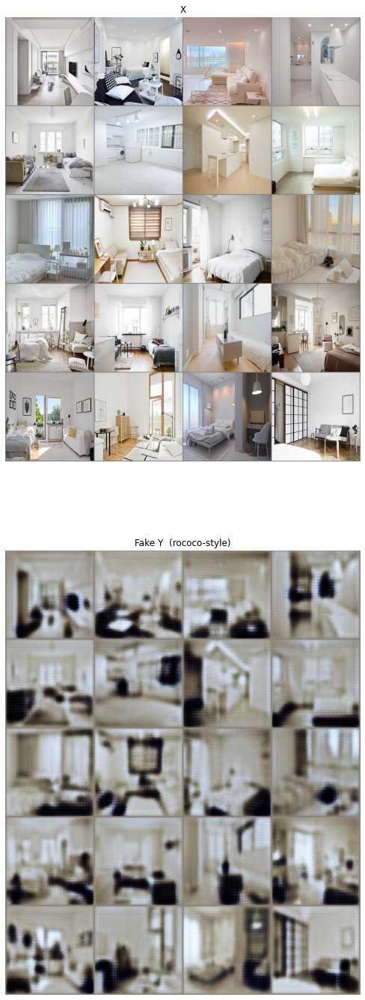

Epoch [   41/  256] | d_total_loss_avg: 0.4077 | g_total_loss: 10.2995
Epoch [   42/  256] | d_total_loss_avg: 0.3925 | g_total_loss: 10.2291
Epoch [   43/  256] | d_total_loss_avg: 0.4012 | g_total_loss: 10.1275
Epoch [   44/  256] | d_total_loss_avg: 0.3744 | g_total_loss: 10.0383
Epoch [   45/  256] | d_total_loss_avg: 0.3847 | g_total_loss: 9.9399
Epoch [   46/  256] | d_total_loss_avg: 0.3801 | g_total_loss: 9.8905
Epoch [   47/  256] | d_total_loss_avg: 0.3805 | g_total_loss: 9.8591
Epoch [   48/  256] | d_total_loss_avg: 0.3703 | g_total_loss: 9.8269
Epoch [   49/  256] | d_total_loss_avg: 0.4039 | g_total_loss: 9.9974
Epoch [   50/  256] | d_total_loss_avg: 0.3552 | g_total_loss: 10.6794


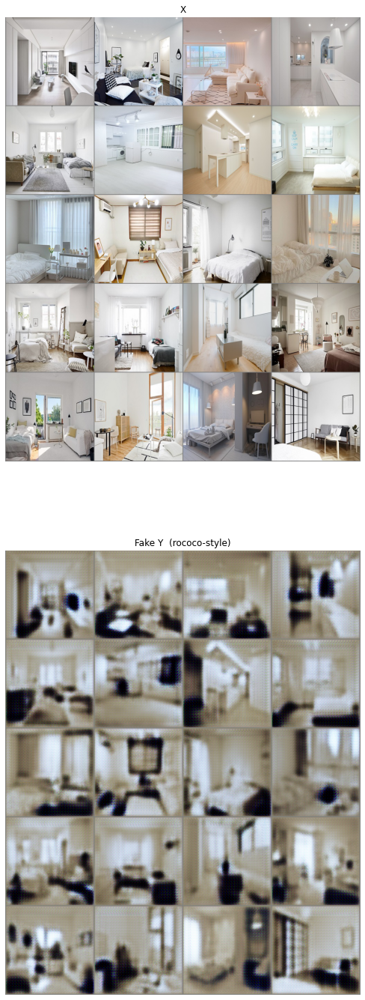

Epoch [   51/  256] | d_total_loss_avg: 0.3959 | g_total_loss: 10.1678
Epoch [   52/  256] | d_total_loss_avg: 0.4048 | g_total_loss: 10.0275
Epoch [   53/  256] | d_total_loss_avg: 0.3745 | g_total_loss: 9.9308
Epoch [   54/  256] | d_total_loss_avg: 0.3302 | g_total_loss: 9.8202
Epoch [   55/  256] | d_total_loss_avg: 0.3565 | g_total_loss: 9.7014
Epoch [   56/  256] | d_total_loss_avg: 0.3835 | g_total_loss: 9.7833
Epoch [   57/  256] | d_total_loss_avg: 0.3243 | g_total_loss: 9.9228
Epoch [   58/  256] | d_total_loss_avg: 0.3399 | g_total_loss: 9.7524
Epoch [   59/  256] | d_total_loss_avg: 0.3671 | g_total_loss: 9.7675
Epoch [   60/  256] | d_total_loss_avg: 0.3626 | g_total_loss: 9.8863


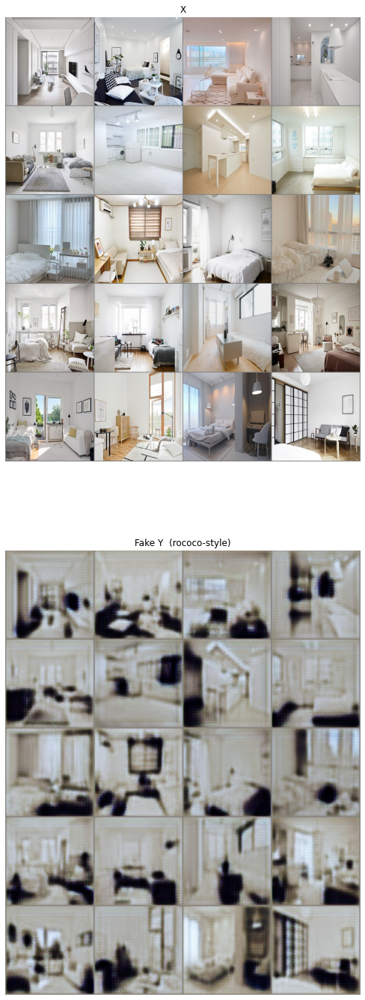

Epoch [   61/  256] | d_total_loss_avg: 0.3322 | g_total_loss: 10.2582
Epoch [   62/  256] | d_total_loss_avg: 0.4227 | g_total_loss: 9.8060
Epoch [   63/  256] | d_total_loss_avg: 0.3160 | g_total_loss: 9.9864
Epoch [   64/  256] | d_total_loss_avg: 0.3414 | g_total_loss: 9.8115
Epoch [   65/  256] | d_total_loss_avg: 0.3838 | g_total_loss: 9.7273
Epoch [   66/  256] | d_total_loss_avg: 0.4129 | g_total_loss: 9.7875
Epoch [   67/  256] | d_total_loss_avg: 0.3404 | g_total_loss: 9.8970
Epoch [   68/  256] | d_total_loss_avg: 0.3775 | g_total_loss: 9.5612
Epoch [   69/  256] | d_total_loss_avg: 0.3687 | g_total_loss: 9.5794
Epoch [   70/  256] | d_total_loss_avg: 0.3422 | g_total_loss: 9.6504


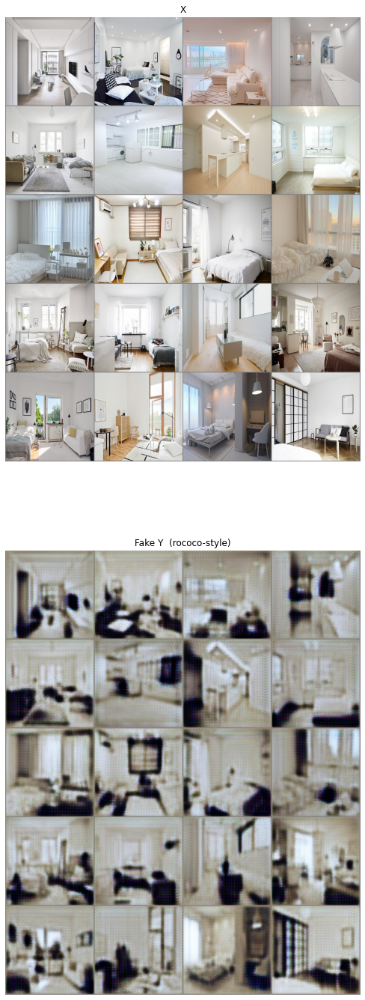

Epoch [   71/  256] | d_total_loss_avg: 0.3759 | g_total_loss: 9.5808
Epoch [   72/  256] | d_total_loss_avg: 0.4278 | g_total_loss: 9.7363
Epoch [   73/  256] | d_total_loss_avg: 0.3428 | g_total_loss: 9.8031
Epoch [   74/  256] | d_total_loss_avg: 0.3822 | g_total_loss: 9.6205
Epoch [   75/  256] | d_total_loss_avg: 0.5667 | g_total_loss: 9.9175
Epoch [   76/  256] | d_total_loss_avg: 0.4988 | g_total_loss: 10.6825
Epoch [   77/  256] | d_total_loss_avg: 0.6097 | g_total_loss: 10.1554
Epoch [   78/  256] | d_total_loss_avg: 0.7043 | g_total_loss: 9.9244
Epoch [   79/  256] | d_total_loss_avg: 0.4819 | g_total_loss: 9.8701
Epoch [   80/  256] | d_total_loss_avg: 0.3302 | g_total_loss: 9.6836


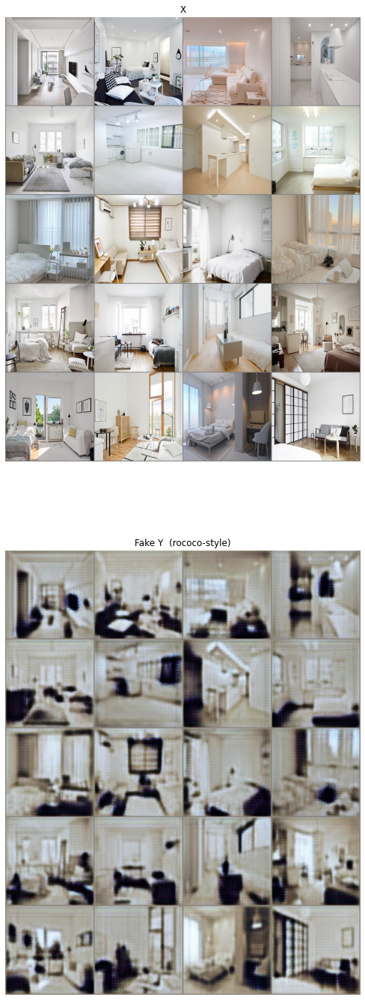

Epoch [   81/  256] | d_total_loss_avg: 0.2894 | g_total_loss: 9.5269
Epoch [   82/  256] | d_total_loss_avg: 0.3219 | g_total_loss: 9.3857
Epoch [   83/  256] | d_total_loss_avg: 0.3147 | g_total_loss: 9.4143
Epoch [   84/  256] | d_total_loss_avg: 0.2858 | g_total_loss: 9.3665
Epoch [   85/  256] | d_total_loss_avg: 0.2978 | g_total_loss: 9.3643
Epoch [   86/  256] | d_total_loss_avg: 0.2864 | g_total_loss: 9.3875
Epoch [   87/  256] | d_total_loss_avg: 0.2918 | g_total_loss: 9.4373
Epoch [   88/  256] | d_total_loss_avg: 0.2642 | g_total_loss: 9.6023
Epoch [   89/  256] | d_total_loss_avg: 0.3651 | g_total_loss: 9.4914
Epoch [   90/  256] | d_total_loss_avg: 0.3127 | g_total_loss: 9.5790


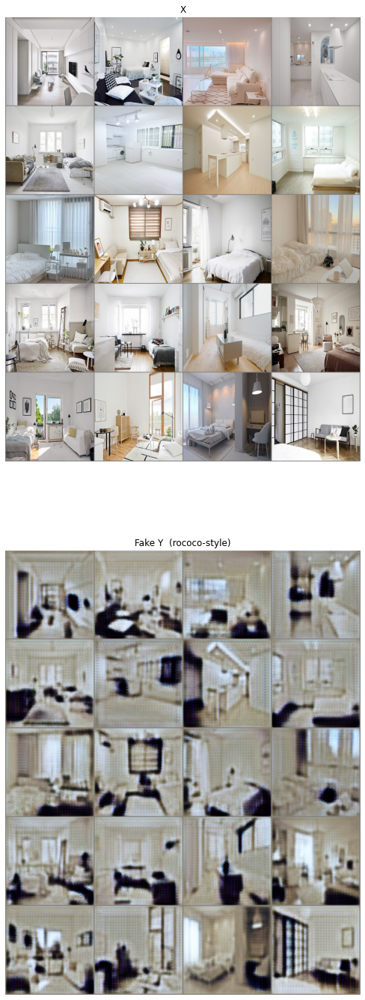

Epoch [   91/  256] | d_total_loss_avg: 0.3388 | g_total_loss: 9.5221
Epoch [   92/  256] | d_total_loss_avg: 0.3205 | g_total_loss: 9.3914
Epoch [   93/  256] | d_total_loss_avg: 0.3099 | g_total_loss: 9.2509
Epoch [   94/  256] | d_total_loss_avg: 0.2861 | g_total_loss: 9.2283
Epoch [   95/  256] | d_total_loss_avg: 0.2760 | g_total_loss: 9.2024
Epoch [   96/  256] | d_total_loss_avg: 0.2703 | g_total_loss: 9.2396
Epoch [   97/  256] | d_total_loss_avg: 0.2351 | g_total_loss: 9.3716
Epoch [   98/  256] | d_total_loss_avg: 0.3011 | g_total_loss: 9.6337
Epoch [   99/  256] | d_total_loss_avg: 0.2272 | g_total_loss: 10.0193
Epoch [  100/  256] | d_total_loss_avg: 0.2535 | g_total_loss: 9.5175


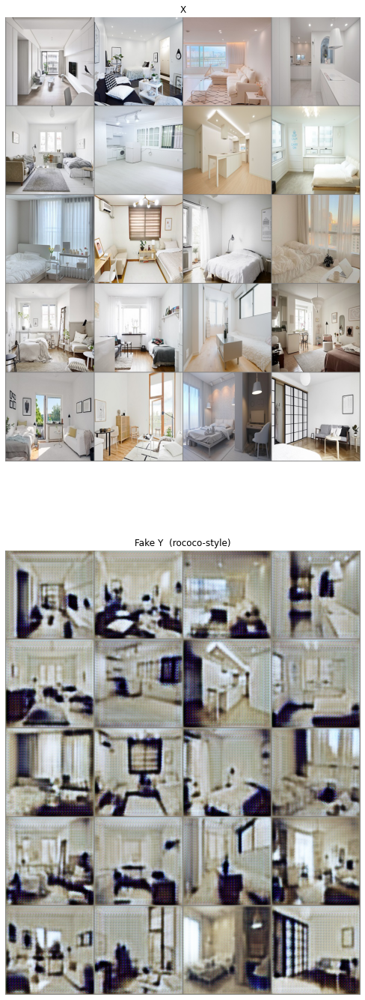

Epoch [  101/  256] | d_total_loss_avg: 0.3213 | g_total_loss: 9.5590
Epoch [  102/  256] | d_total_loss_avg: 0.2686 | g_total_loss: 9.3337
Epoch [  103/  256] | d_total_loss_avg: 0.2671 | g_total_loss: 9.2628
Epoch [  104/  256] | d_total_loss_avg: 0.3201 | g_total_loss: 9.2118
Epoch [  105/  256] | d_total_loss_avg: 0.2978 | g_total_loss: 9.3653
Epoch [  106/  256] | d_total_loss_avg: 0.3486 | g_total_loss: 9.4447
Epoch [  107/  256] | d_total_loss_avg: 0.4212 | g_total_loss: 9.6062
Epoch [  108/  256] | d_total_loss_avg: 0.5897 | g_total_loss: 9.4256
Epoch [  109/  256] | d_total_loss_avg: 0.6170 | g_total_loss: 9.3772
Epoch [  110/  256] | d_total_loss_avg: 0.5255 | g_total_loss: 9.2917


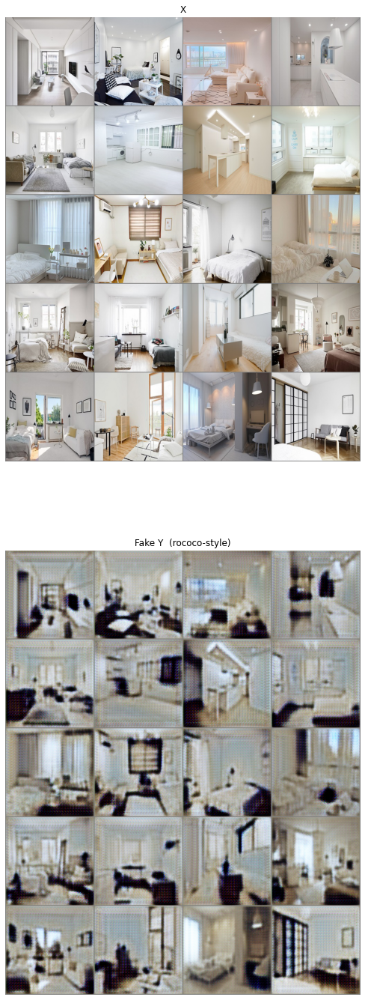

Epoch [  111/  256] | d_total_loss_avg: 0.4604 | g_total_loss: 9.2835
Epoch [  112/  256] | d_total_loss_avg: 0.4113 | g_total_loss: 9.3095
Epoch [  113/  256] | d_total_loss_avg: 0.3299 | g_total_loss: 9.2765
Epoch [  114/  256] | d_total_loss_avg: 0.2368 | g_total_loss: 9.1765
Epoch [  115/  256] | d_total_loss_avg: 0.2982 | g_total_loss: 9.1983
Epoch [  116/  256] | d_total_loss_avg: 0.2266 | g_total_loss: 9.2051
Epoch [  117/  256] | d_total_loss_avg: 0.2774 | g_total_loss: 9.0774
Epoch [  118/  256] | d_total_loss_avg: 0.2515 | g_total_loss: 9.1100
Epoch [  119/  256] | d_total_loss_avg: 0.2372 | g_total_loss: 9.1192
Epoch [  120/  256] | d_total_loss_avg: 0.2539 | g_total_loss: 9.1113


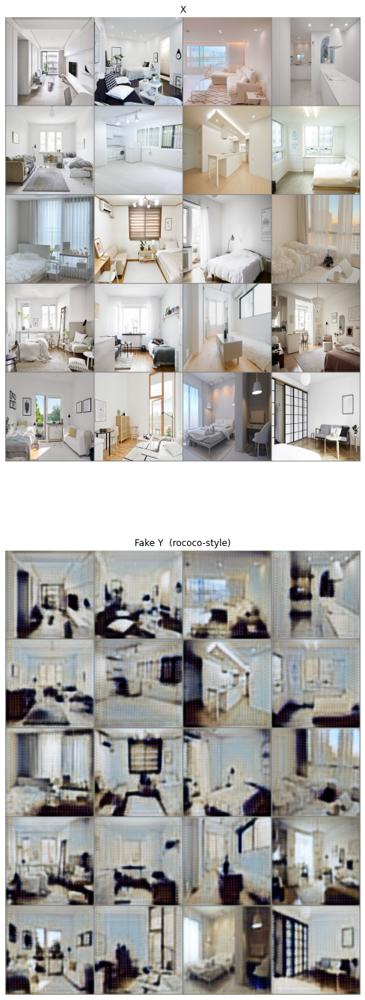

Epoch [  121/  256] | d_total_loss_avg: 0.2309 | g_total_loss: 9.2475
Epoch [  122/  256] | d_total_loss_avg: 0.2449 | g_total_loss: 9.5230
Epoch [  123/  256] | d_total_loss_avg: 0.3083 | g_total_loss: 9.2858
Epoch [  124/  256] | d_total_loss_avg: 0.2981 | g_total_loss: 9.2355
Epoch [  125/  256] | d_total_loss_avg: 0.3050 | g_total_loss: 9.0978
Epoch [  126/  256] | d_total_loss_avg: 0.3070 | g_total_loss: 9.2093
Epoch [  127/  256] | d_total_loss_avg: 0.2774 | g_total_loss: 9.1350
Epoch [  128/  256] | d_total_loss_avg: 0.2316 | g_total_loss: 9.1900
Epoch [  129/  256] | d_total_loss_avg: 0.2975 | g_total_loss: 9.4490
Epoch [  130/  256] | d_total_loss_avg: 0.2127 | g_total_loss: 9.6674


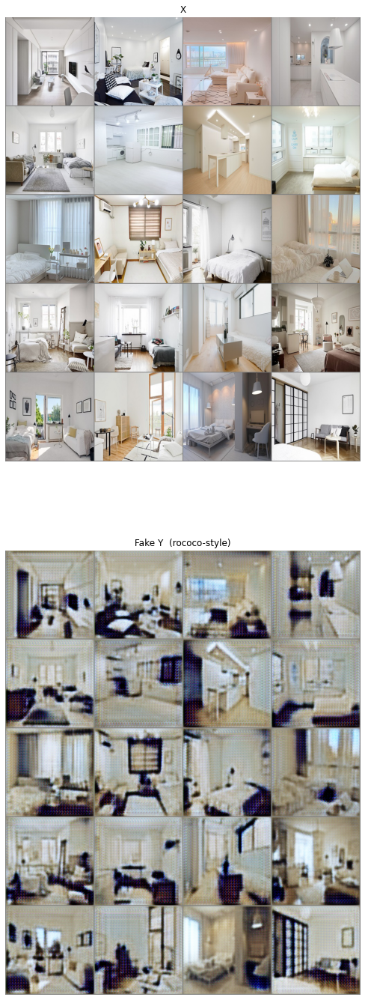

Epoch [  131/  256] | d_total_loss_avg: 0.2429 | g_total_loss: 9.2439
Epoch [  132/  256] | d_total_loss_avg: 0.2463 | g_total_loss: 9.3218
Epoch [  133/  256] | d_total_loss_avg: 0.2015 | g_total_loss: 9.2835
Epoch [  134/  256] | d_total_loss_avg: 0.2242 | g_total_loss: 9.1017
Epoch [  135/  256] | d_total_loss_avg: 0.2689 | g_total_loss: 9.1641
Epoch [  136/  256] | d_total_loss_avg: 0.2126 | g_total_loss: 9.0538
Epoch [  137/  256] | d_total_loss_avg: 0.2498 | g_total_loss: 9.0922
Epoch [  138/  256] | d_total_loss_avg: 0.2403 | g_total_loss: 8.9988
Epoch [  139/  256] | d_total_loss_avg: 0.2749 | g_total_loss: 9.1384
Epoch [  140/  256] | d_total_loss_avg: 0.2840 | g_total_loss: 9.1054


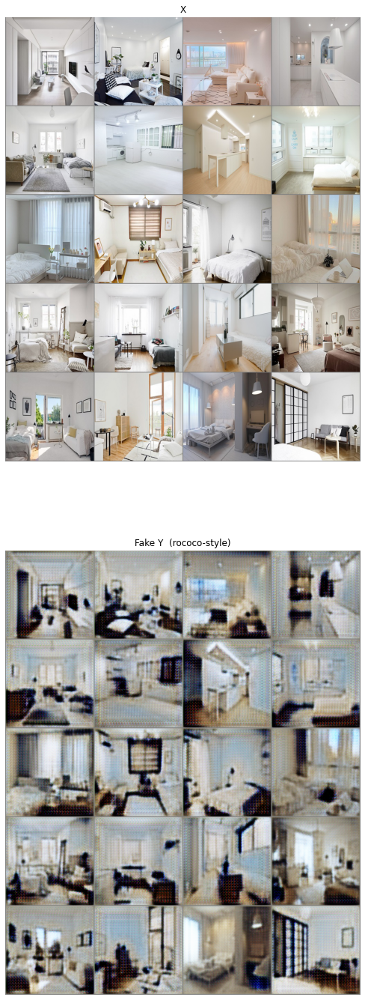

Epoch [  141/  256] | d_total_loss_avg: 0.2144 | g_total_loss: 9.1587
Epoch [  142/  256] | d_total_loss_avg: 0.2508 | g_total_loss: 9.1582
Epoch [  143/  256] | d_total_loss_avg: 0.2288 | g_total_loss: 9.1048
Epoch [  144/  256] | d_total_loss_avg: 0.2484 | g_total_loss: 9.0944
Epoch [  145/  256] | d_total_loss_avg: 0.2842 | g_total_loss: 9.1700
Epoch [  146/  256] | d_total_loss_avg: 0.3884 | g_total_loss: 9.2272
Epoch [  147/  256] | d_total_loss_avg: 0.5319 | g_total_loss: 9.2106
Epoch [  148/  256] | d_total_loss_avg: 0.5986 | g_total_loss: 9.3150
Epoch [  149/  256] | d_total_loss_avg: 0.6978 | g_total_loss: 9.4764
Epoch [  150/  256] | d_total_loss_avg: 0.3826 | g_total_loss: 9.4705


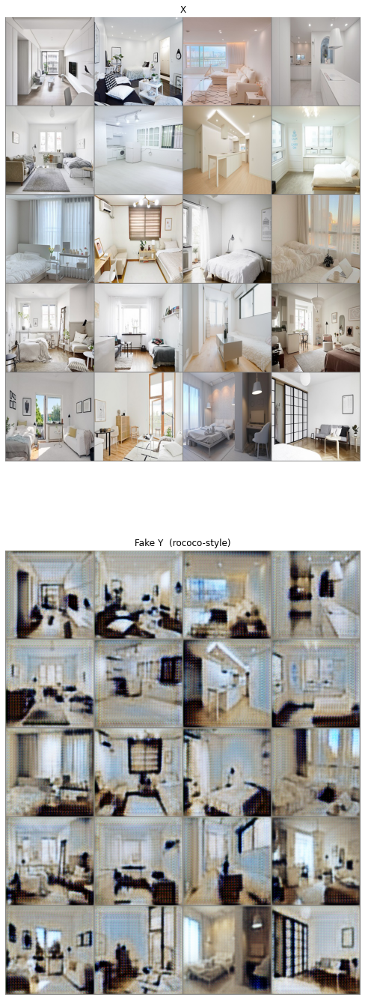

Epoch [  151/  256] | d_total_loss_avg: 0.3447 | g_total_loss: 9.1434
Epoch [  152/  256] | d_total_loss_avg: 0.4159 | g_total_loss: 9.4682
Epoch [  153/  256] | d_total_loss_avg: 0.2716 | g_total_loss: 9.2099
Epoch [  154/  256] | d_total_loss_avg: 0.2749 | g_total_loss: 9.1270
Epoch [  155/  256] | d_total_loss_avg: 0.4414 | g_total_loss: 9.2433
Epoch [  156/  256] | d_total_loss_avg: 0.3103 | g_total_loss: 9.2838
Epoch [  157/  256] | d_total_loss_avg: 0.3175 | g_total_loss: 9.0782
Epoch [  158/  256] | d_total_loss_avg: 0.3402 | g_total_loss: 9.1122
Epoch [  159/  256] | d_total_loss_avg: 0.3464 | g_total_loss: 9.0498
Epoch [  160/  256] | d_total_loss_avg: 0.2510 | g_total_loss: 8.9304


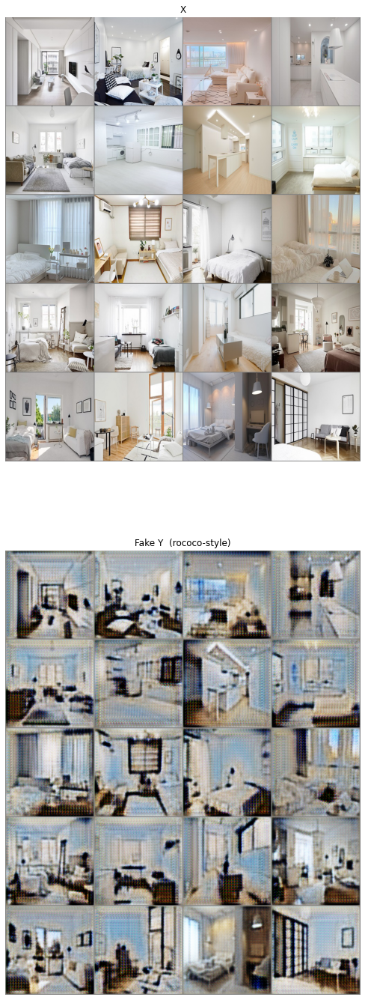

Epoch [  161/  256] | d_total_loss_avg: 0.2462 | g_total_loss: 9.0332
Epoch [  162/  256] | d_total_loss_avg: 0.2219 | g_total_loss: 9.0134
Epoch [  163/  256] | d_total_loss_avg: 0.2057 | g_total_loss: 9.0206
Epoch [  164/  256] | d_total_loss_avg: 0.2380 | g_total_loss: 8.9857
Epoch [  165/  256] | d_total_loss_avg: 0.1951 | g_total_loss: 8.9350
Epoch [  166/  256] | d_total_loss_avg: 0.2647 | g_total_loss: 9.0924
Epoch [  167/  256] | d_total_loss_avg: 0.2378 | g_total_loss: 9.0500
Epoch [  168/  256] | d_total_loss_avg: 0.2246 | g_total_loss: 8.9396
Epoch [  169/  256] | d_total_loss_avg: 0.2780 | g_total_loss: 9.0483
Epoch [  170/  256] | d_total_loss_avg: 0.2094 | g_total_loss: 8.8494


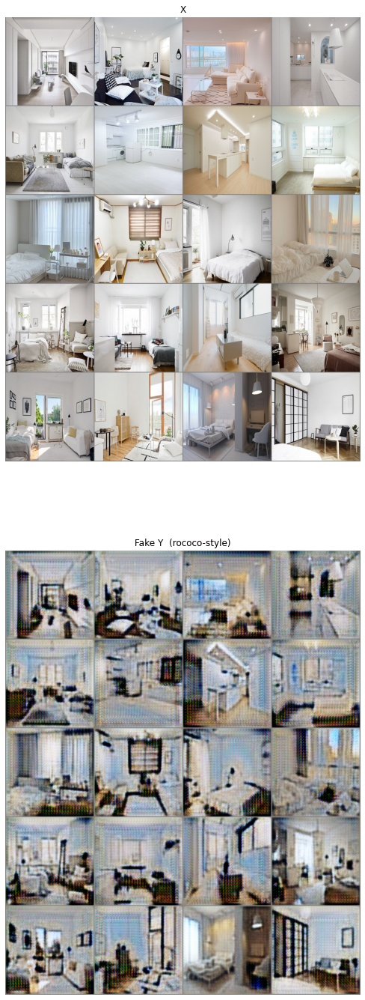

Epoch [  171/  256] | d_total_loss_avg: 0.3007 | g_total_loss: 9.0417
Epoch [  172/  256] | d_total_loss_avg: 0.3881 | g_total_loss: 9.0867
Epoch [  173/  256] | d_total_loss_avg: 0.2399 | g_total_loss: 8.9527
Epoch [  174/  256] | d_total_loss_avg: 0.2525 | g_total_loss: 8.9233
Epoch [  175/  256] | d_total_loss_avg: 0.2707 | g_total_loss: 9.0896
Epoch [  176/  256] | d_total_loss_avg: 0.2205 | g_total_loss: 9.0196
Epoch [  177/  256] | d_total_loss_avg: 0.2179 | g_total_loss: 9.1010
Epoch [  178/  256] | d_total_loss_avg: 0.2855 | g_total_loss: 9.1574
Epoch [  179/  256] | d_total_loss_avg: 0.1943 | g_total_loss: 9.0488
Epoch [  180/  256] | d_total_loss_avg: 0.2024 | g_total_loss: 8.9414


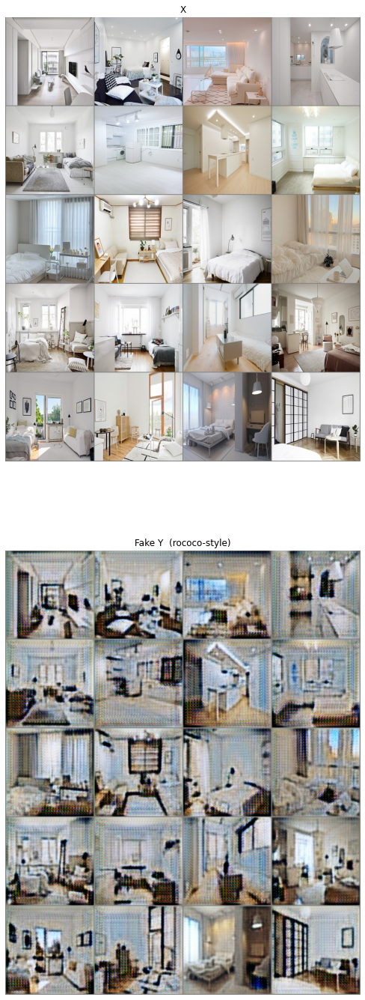

Epoch [  181/  256] | d_total_loss_avg: 0.2807 | g_total_loss: 9.0926
Epoch [  182/  256] | d_total_loss_avg: 0.2642 | g_total_loss: 8.9254
Epoch [  183/  256] | d_total_loss_avg: 0.2478 | g_total_loss: 9.0773
Epoch [  184/  256] | d_total_loss_avg: 0.3667 | g_total_loss: 9.1362
Epoch [  185/  256] | d_total_loss_avg: 0.3189 | g_total_loss: 9.1796
Epoch [  186/  256] | d_total_loss_avg: 0.2833 | g_total_loss: 9.4890
Epoch [  187/  256] | d_total_loss_avg: 0.4141 | g_total_loss: 9.4444
Epoch [  188/  256] | d_total_loss_avg: 0.4763 | g_total_loss: 9.1964
Epoch [  189/  256] | d_total_loss_avg: 0.2841 | g_total_loss: 9.0882
Epoch [  190/  256] | d_total_loss_avg: 0.3598 | g_total_loss: 9.1237


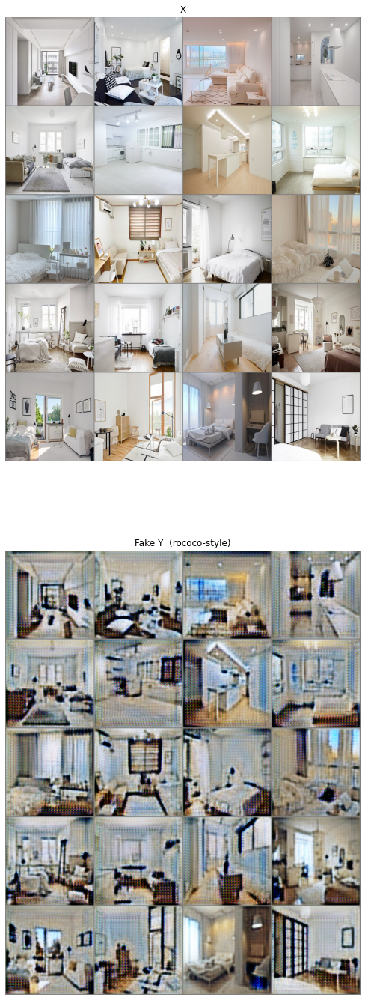

Epoch [  191/  256] | d_total_loss_avg: 0.3801 | g_total_loss: 9.0774
Epoch [  192/  256] | d_total_loss_avg: 0.3282 | g_total_loss: 8.8478
Epoch [  193/  256] | d_total_loss_avg: 0.2649 | g_total_loss: 8.9029
Epoch [  194/  256] | d_total_loss_avg: 0.2868 | g_total_loss: 8.8967
Epoch [  195/  256] | d_total_loss_avg: 0.2399 | g_total_loss: 8.9561
Epoch [  196/  256] | d_total_loss_avg: 0.1827 | g_total_loss: 8.9419
Epoch [  197/  256] | d_total_loss_avg: 0.2571 | g_total_loss: 9.0203
Epoch [  198/  256] | d_total_loss_avg: 0.2442 | g_total_loss: 8.8776
Epoch [  199/  256] | d_total_loss_avg: 0.2329 | g_total_loss: 8.8850
Epoch [  200/  256] | d_total_loss_avg: 0.2299 | g_total_loss: 8.9175


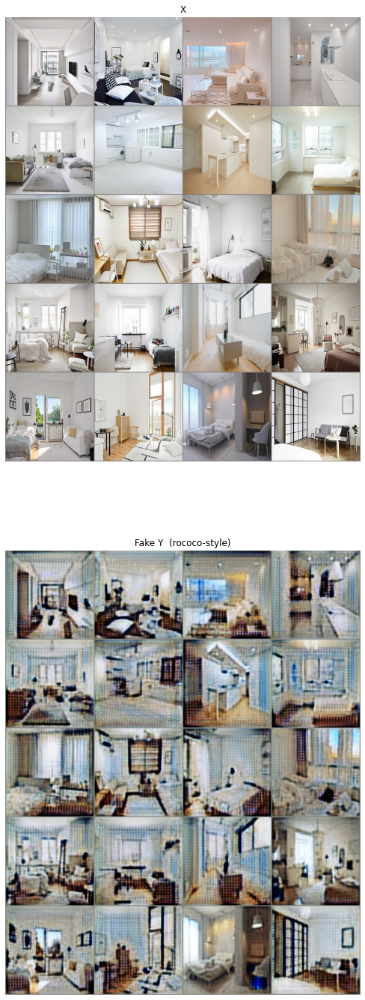

Epoch [  201/  256] | d_total_loss_avg: 0.2386 | g_total_loss: 9.0284
Epoch [  202/  256] | d_total_loss_avg: 0.2194 | g_total_loss: 8.9303
Epoch [  203/  256] | d_total_loss_avg: 0.2799 | g_total_loss: 9.0397
Epoch [  204/  256] | d_total_loss_avg: 0.3246 | g_total_loss: 8.9978
Epoch [  205/  256] | d_total_loss_avg: 0.2679 | g_total_loss: 9.0062
Epoch [  206/  256] | d_total_loss_avg: 0.3911 | g_total_loss: 9.4101
Epoch [  207/  256] | d_total_loss_avg: 0.5536 | g_total_loss: 9.3038
Epoch [  208/  256] | d_total_loss_avg: 0.4775 | g_total_loss: 9.0332
Epoch [  209/  256] | d_total_loss_avg: 0.4142 | g_total_loss: 8.9275
Epoch [  210/  256] | d_total_loss_avg: 0.3709 | g_total_loss: 8.8972


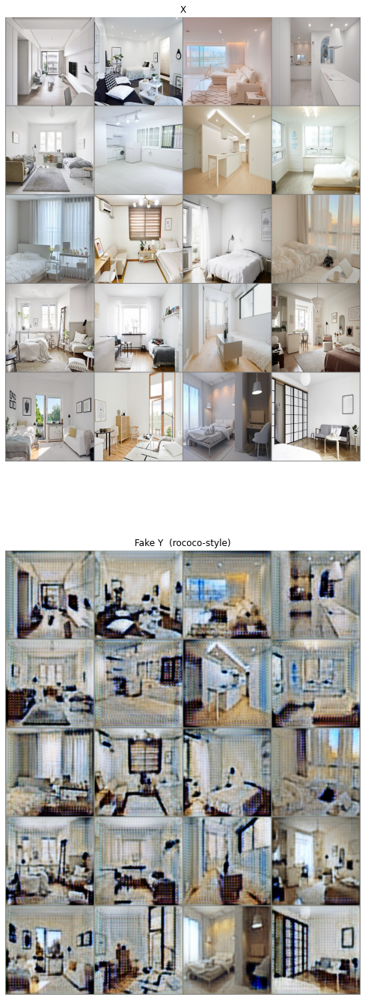

Epoch [  211/  256] | d_total_loss_avg: 0.2699 | g_total_loss: 8.8873
Epoch [  212/  256] | d_total_loss_avg: 0.2433 | g_total_loss: 8.9086
Epoch [  213/  256] | d_total_loss_avg: 0.2802 | g_total_loss: 8.9054
Epoch [  214/  256] | d_total_loss_avg: 0.1860 | g_total_loss: 8.8145
Epoch [  215/  256] | d_total_loss_avg: 0.2986 | g_total_loss: 9.1412
Epoch [  216/  256] | d_total_loss_avg: 0.3237 | g_total_loss: 9.2901
Epoch [  217/  256] | d_total_loss_avg: 0.1862 | g_total_loss: 8.7995
Epoch [  218/  256] | d_total_loss_avg: 0.2298 | g_total_loss: 9.2266
Epoch [  219/  256] | d_total_loss_avg: 0.2487 | g_total_loss: 9.1677
Epoch [  220/  256] | d_total_loss_avg: 0.3122 | g_total_loss: 9.0978


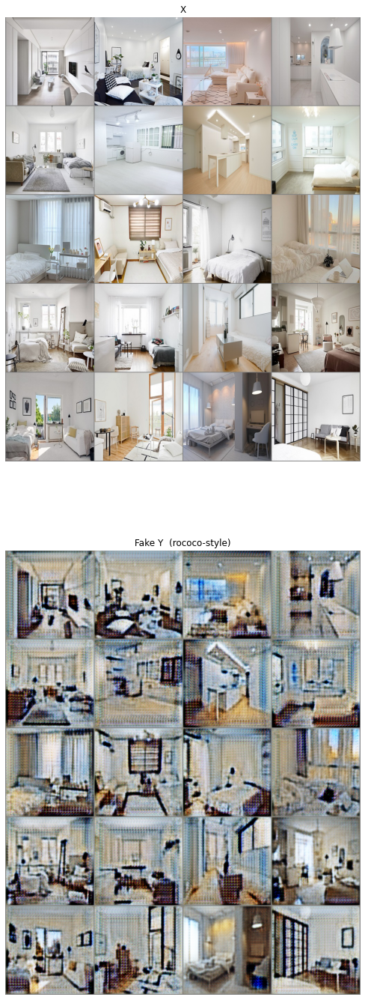

Epoch [  221/  256] | d_total_loss_avg: 0.3486 | g_total_loss: 8.9989
Epoch [  222/  256] | d_total_loss_avg: 0.2621 | g_total_loss: 8.8994
Epoch [  223/  256] | d_total_loss_avg: 0.2977 | g_total_loss: 8.9555
Epoch [  224/  256] | d_total_loss_avg: 0.2606 | g_total_loss: 8.9693
Epoch [  225/  256] | d_total_loss_avg: 0.1735 | g_total_loss: 8.8288
Epoch [  226/  256] | d_total_loss_avg: 0.1851 | g_total_loss: 8.8391
Epoch [  227/  256] | d_total_loss_avg: 0.2163 | g_total_loss: 8.8920
Epoch [  228/  256] | d_total_loss_avg: 0.1852 | g_total_loss: 8.7616
Epoch [  229/  256] | d_total_loss_avg: 0.1467 | g_total_loss: 8.8162
Epoch [  230/  256] | d_total_loss_avg: 0.2618 | g_total_loss: 9.0386


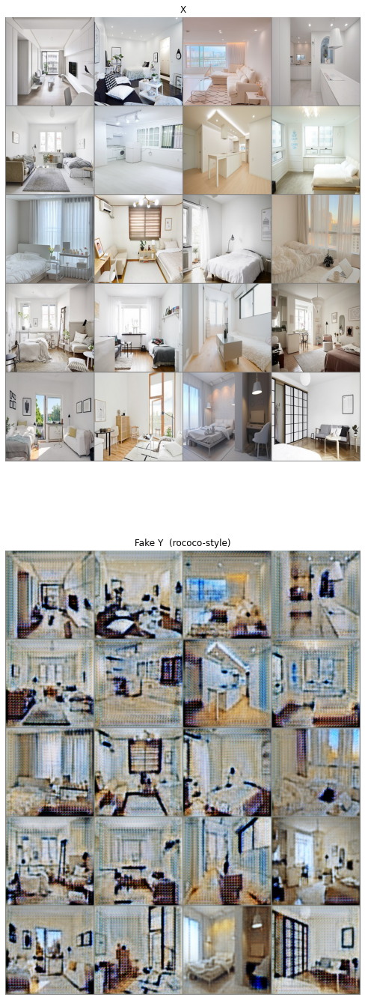

Epoch [  231/  256] | d_total_loss_avg: 0.2524 | g_total_loss: 8.8841
Epoch [  232/  256] | d_total_loss_avg: 0.2311 | g_total_loss: 8.8808
Epoch [  233/  256] | d_total_loss_avg: 0.2328 | g_total_loss: 8.9518
Epoch [  234/  256] | d_total_loss_avg: 0.2099 | g_total_loss: 8.7646
Epoch [  235/  256] | d_total_loss_avg: 0.1862 | g_total_loss: 8.8647
Epoch [  236/  256] | d_total_loss_avg: 0.2686 | g_total_loss: 8.9449
Epoch [  237/  256] | d_total_loss_avg: 0.2975 | g_total_loss: 8.9234
Epoch [  238/  256] | d_total_loss_avg: 0.2053 | g_total_loss: 8.7793
Epoch [  239/  256] | d_total_loss_avg: 0.2990 | g_total_loss: 9.0447
Epoch [  240/  256] | d_total_loss_avg: 0.3226 | g_total_loss: 8.9788


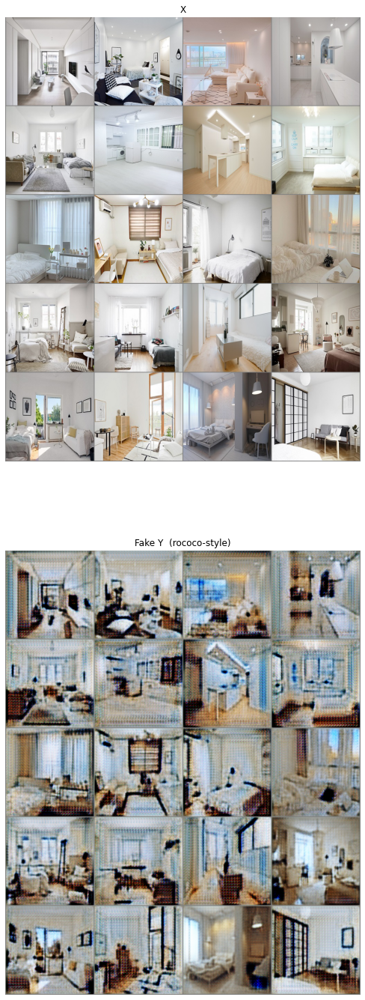

Epoch [  241/  256] | d_total_loss_avg: 0.2161 | g_total_loss: 8.7382
Epoch [  242/  256] | d_total_loss_avg: 0.2374 | g_total_loss: 8.9483
Epoch [  243/  256] | d_total_loss_avg: 0.3253 | g_total_loss: 8.9784
Epoch [  244/  256] | d_total_loss_avg: 0.4017 | g_total_loss: 8.9109
Epoch [  245/  256] | d_total_loss_avg: 0.3180 | g_total_loss: 8.7005
Epoch [  246/  256] | d_total_loss_avg: 0.3197 | g_total_loss: 8.9872
Epoch [  247/  256] | d_total_loss_avg: 0.2896 | g_total_loss: 9.0303
Epoch [  248/  256] | d_total_loss_avg: 0.2268 | g_total_loss: 9.0303
Epoch [  249/  256] | d_total_loss_avg: 0.1492 | g_total_loss: 8.9721
Epoch [  250/  256] | d_total_loss_avg: 0.3175 | g_total_loss: 9.1983


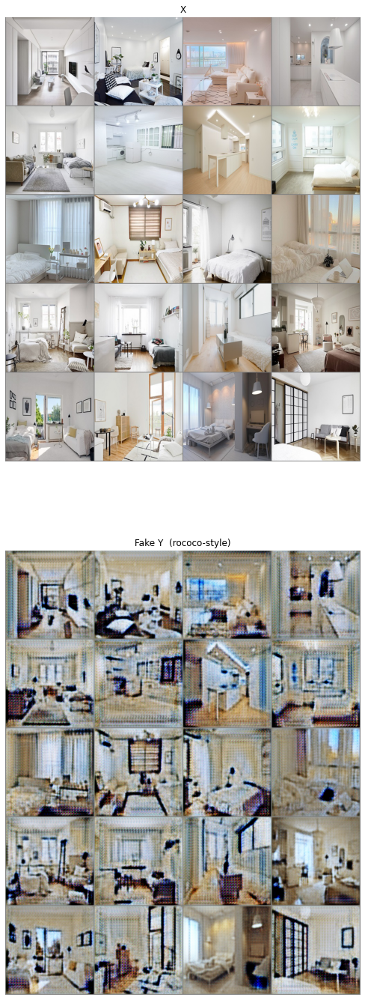

Epoch [  251/  256] | d_total_loss_avg: 0.3014 | g_total_loss: 9.0504
Epoch [  252/  256] | d_total_loss_avg: 0.3028 | g_total_loss: 9.0561
Epoch [  253/  256] | d_total_loss_avg: 0.2957 | g_total_loss: 9.1531
Epoch [  254/  256] | d_total_loss_avg: 0.2933 | g_total_loss: 8.9052
Epoch [  255/  256] | d_total_loss_avg: 0.3319 | g_total_loss: 8.9808
Epoch [  256/  256] | d_total_loss_avg: 0.3333 | g_total_loss: 8.9833


In [ ]:
fig = plt.figure(figsize=(36, 24))
n_epochs = epoch_true * batches_per_epoch
losses = training_loop(dataloader_X, dataloader_Y, test_dataloader_X, test_dataloader_Y, n_epochs=n_epochs)

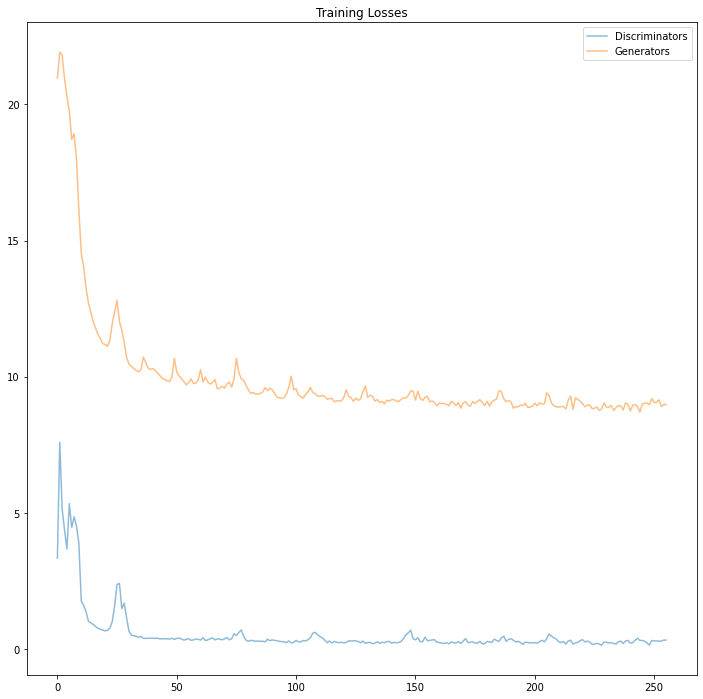

In [ ]:
#Plot loss functions over training
fig, ax = plt.subplots(figsize=(12,12))
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminators', alpha=0.5)
plt.plot(losses.T[1], label='Generators', alpha=0.5)
plt.title("Training Losses")
plt.legend()
plt.show()

In [ ]:
#Get some fixed data from domains X and Y for sampling. These are images that are held constant throughout training, that allow us to inspect the model's performance.
test_iter_X = iter(test_dataloader_X)
test_iter_Y = iter(test_dataloader_Y)

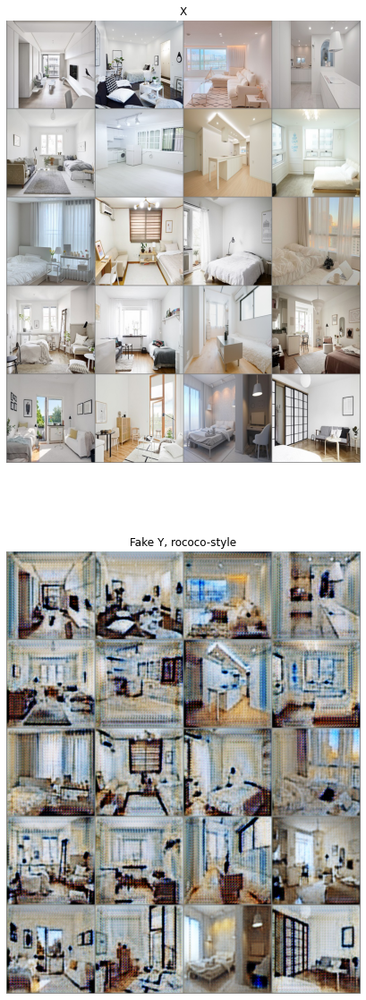

In [ ]:
#Sample
fixed_X = test_iter_X.next()

#Evaluation
G_XtoY.eval()

mean_=0.5
std_=0.5

#Identify correct device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
#Create fake pictures for both cycles
fake_Y = G_XtoY(fixed_X.to(device))
    
#Generate grids
grid_x =  make_grid(fixed_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
grid_fake_y =  make_grid(fake_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy() 
    
#Normalize pictures to pixel range rom 0 to 255
X, fake_Y_ = reverse_normalize(grid_x, mean_, std_), reverse_normalize(grid_fake_y, mean_, std_)

#Transformation from X -> Y
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(30, 20))
ax1.imshow(X)
ax1.axis('off')
ax1.set_title('X')
ax2.imshow(fake_Y_)
ax2.axis('off')
ax2.set_title('Fake Y, rococo-style')
plt.show()

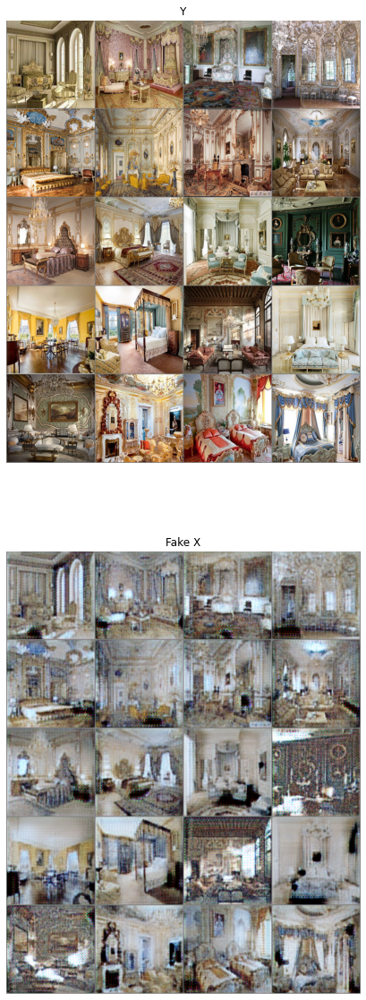

In [ ]:
#Sample
fixed_Y = test_iter_Y.next()


#Evaluation
G_YtoX.eval()

mean_=0.5
std_=0.5

#Identify correct device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
#Create fake pictures for both cycles
fake_X = G_YtoX(fixed_Y.to(device))
    
#Generate grids
grid_y =  make_grid(fixed_Y, nrow=4).permute(1, 2, 0).detach().cpu().numpy()
grid_fake_x =  make_grid(fake_X, nrow=4).permute(1, 2, 0).detach().cpu().numpy()  
    
#Normalize pictures to pixel range rom 0 to 255
Y, fake_X_ = reverse_normalize(grid_y, mean_, std_), reverse_normalize(grid_fake_x, mean_, std_)

#Transformation from Y -> X
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, sharey=True, figsize=(30, 20))
ax1.imshow(Y)
ax1.axis('off')
ax1.set_title('Y')
ax2.imshow(fake_X_)
ax2.axis('off')
ax2.set_title('Fake X')
plt.show()


In [ ]:
#Directory
! mkdir ./images

mkdir: cannot create directory ‘./images’: File exists


In [ ]:
#Set model to evaluation
G_XtoY.eval()

#Get data loader for final transformation / submission
submit_dataloader = DataLoader(dataset_room, batch_size=1, shuffle=False, pin_memory=True)
dataiter = iter(submit_dataloader)

#Previous normalization choosen
mean_=0.5 
std_=0.5

#Loop through each picture
for image_idx in range(0, len(submit_dataloader)):
        
    #Get base picture
    fixed_X = dataiter.next()
    
    #Identify correct device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    #Create fake pictures (monet-esque)
    fake_Y = G_XtoY(fixed_X.to(device))
    fake_Y = fake_Y.detach().cpu().numpy()
    fake_Y = reverse_normalize(fake_Y, mean_, std_)
    fake_Y = fake_Y[0].transpose(1, 2, 0)
    fake_Y = np.uint8(fake_Y)
    fake_Y = Image.fromarray(fake_Y)
    #print(fake_Y.shape)
    
    #Save picture
    fake_Y.save("./images/" + str(image_idx) + ".jpg")

#Back to it
G_XtoY.train()

CycleGenerator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (conv2): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(256, eps=1e-05, momentu